In [43]:
from configparser import ConfigParser
import psycopg2
import numpy as np
import pandas as pd
import matplotlib
%matplotlib inline
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeClassifier
from sklearn.svm import LinearSVC
from sklearn.metrics import recall_score, precision_score
#Can be very helpful to notice any imbalance in classes
from collections import Counter 

In [44]:
#Sourced from https://www.postgresqltutorial.com/postgresql-python/connect/
def config(filename='psql_sample.ini', section='postgresql'):
    parser = ConfigParser()
    # read config file
    parser.read(filename) 
 
    # get section, default to postgresql
    db = {}
    if parser.has_section(section):
        params = parser.items(section)
        for param in params:
            db[param[0]] = param[1]
    else:
        raise Exception('Section {0} not found in the {1} file'.format(section, filename))
 
    return db

In [45]:
#Get the configuration file as a python dictionary
cfg = config()

In [46]:
#Establish the connection and create a cursor to the database
try:
    print("Here's an attempt to connect to the database")
    conn = psycopg2.connect(**cfg)
    cursor = conn.cursor()
    print("Look's like it was a success")
    
except (Exception, psycopg2.DatabaseError) as error:
    print(error)

Here's an attempt to connect to the database
Look's like it was a success


In [47]:
try:
    #Lets get our data 
    cursor.execute("SELECT age_group,rain_amount,snow_amount,retail_and_recreation_percentage,grocery_and_pharmacy_percentage,workplaces_percentage,residential_percentage,parks_percentage,is_fatal,is_resolved,is_unresolved from data_mart.fact_table as fact inner join data_mart.mobility_dimension as mobility on fact.mobility_key=mobility.mobility_key inner join data_mart.weather_dimension as weather on fact.weather_key=weather.weather_key inner join data_mart.patient_dimension as patient on fact.patient_key=patient.patient_key") 

    #Get the complete result set. It will be a list of tuples where each tuple is a row from the result set
    result_list = cursor.fetchall()
        
except (Exception, psycopg2.DatabaseError) as error:
    print(error)

In [48]:
#Ensure to run this cell at the end of all your experiments to close all connections
cursor.close()
conn.close()

In [49]:
#Now, 
result_df = pd.DataFrame(result_list, columns=["age_group","rain_amount","snow_amount", "parks_percentage", "retail_and_recreation_percentage","grocery_and_pharmacy_percentage","workplaces_percentage","residential_percentage",
                                               "is_fatal", "is_resolved","is_unresolved"])


In [8]:
result_df.head()

,age_group,rain_amount,snow_amount,parks_percentage,retail_and_recreation_percentage,grocery_and_pharmacy_percentage,workplaces_percentage,residential_percentage,is_fatal,is_resolved,is_unresolved
0,40s,1.6,0.0,-15.0,-1.0,-44.0,13.0,71.0,False,True,False
1,50s,1.6,0.0,-15.0,-1.0,-44.0,13.0,71.0,False,True,False
2,<20,1.6,0.0,-15.0,-1.0,-44.0,13.0,71.0,False,True,False
3,30s,1.6,0.0,-15.0,-1.0,-44.0,13.0,71.0,False,True,False
4,20s,1.6,0.0,-11.0,4.0,-50.0,16.0,NaN,False,True,False


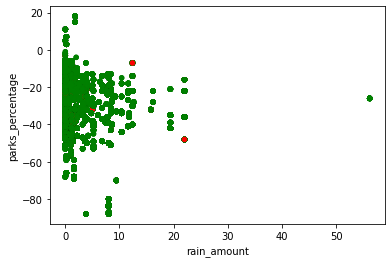

In [88]:
#Scatter plot

colors = np.where(result_df["is_fatal"]==True,'r','g')#where true=red if not green
ax1 = result_df.plot.scatter(x='rain_amount',
                      y='parks_percentage',
                      c=colors)

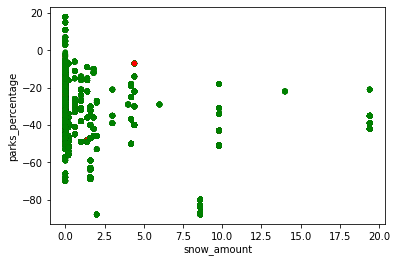

In [91]:
ax3 = result_df.plot.scatter(x='snow_amount',
                      y='parks_percentage',
                      c=colors)

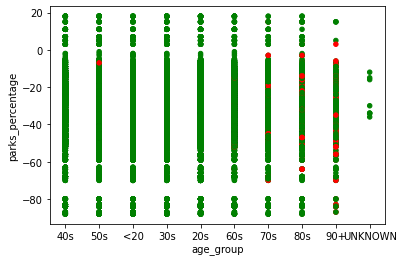

In [10]:

colors = np.where(result_df["is_fatal"]==True,'r','g')#where true=red if not green
ax2 = result_df.plot.scatter(x='age_group',
                      y='parks_percentage',
                      c=colors)

C:\Users\Maxime\AppData\Local\Programs\Python\Python39\lib\site-packages\pandas\plotting\_matplotlib\tools.py:400: MatplotlibDeprecationWarning: 
The is_first_col function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use ax.get_subplotspec().is_first_col() instead.
  if ax.is_first_col():


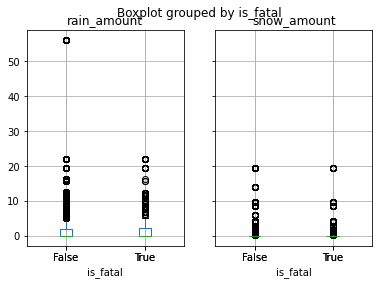

In [11]:
#box plots
boxplot1 = result_df.boxplot(by='is_fatal',column=['rain_amount', 'snow_amount'])

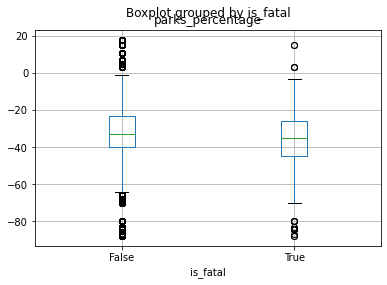

In [90]:
boxplot2 = result_df.boxplot(by='is_fatal',column=['parks_percentage'])

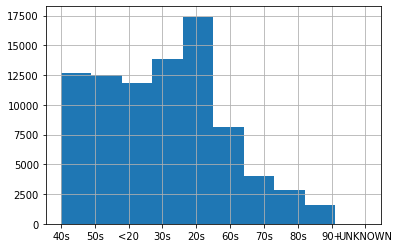

In [27]:
#histogram for the total number of cases
hist = result_df['age_group'].hist()

<AxesSubplot:xlabel='age_group,is_fatal'>

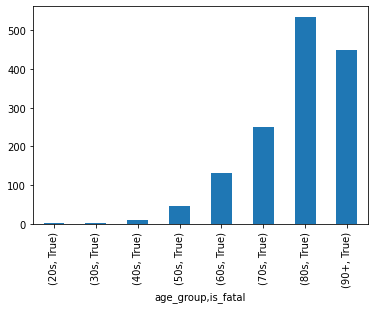

In [69]:
groups=result_df[result_df['is_fatal']==True].groupby(['age_group','is_fatal']).size()
groups.plot.bar()

<AxesSubplot:xlabel='snow_amount,is_fatal'>

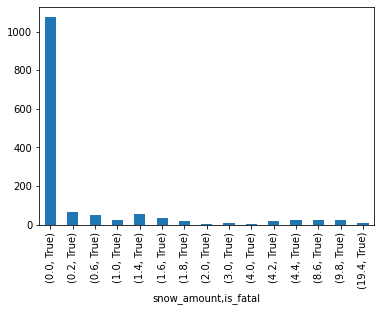

In [72]:
snow=result_df[result_df['is_fatal']==True].groupby(['snow_amount','is_fatal']).size()
snow.plot.bar()

<AxesSubplot:xlabel='rain_amount,is_fatal'>

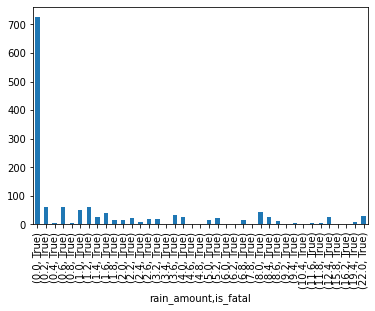

In [73]:
rain=result_df[result_df['is_fatal']==True].groupby(['rain_amount','is_fatal']).size()
rain.plot.bar()

<AxesSubplot:>

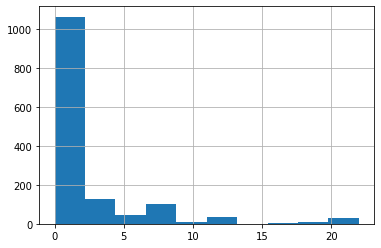

In [79]:
result_df['rain_amount'][result_df['is_fatal']==True].hist()

<AxesSubplot:>

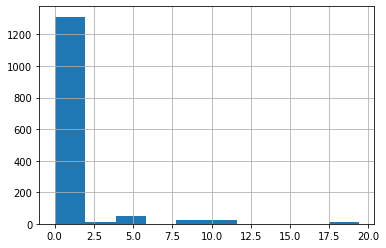

In [80]:
result_df['snow_amount'][result_df['is_fatal']==True].hist()

<AxesSubplot:>

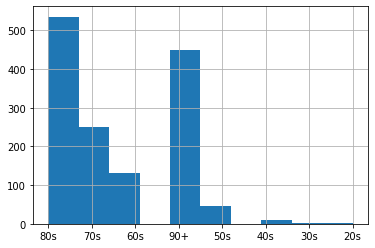

In [81]:
result_df['age_group'][result_df['is_fatal']==True].hist()